# Gather: Flood forcings data

In data science, the initial phase known as "data gathering" is an essential step: collection and preliminary processing of raw data, which will be used for analytical and modeling. In this notebook, global data sources are used due to their detailed documentation, open source license, and structured format. Global data sources typically offer broader spatial coverage, although the accuracy need to be improved when compared to local data. Research efforts have been dedicated to ensuring the reliability of the global data and its assimilation to the local data.


If you possess access to local data, you may use it for this analysis. Ensure that following steps is followed before integrating local data into your analysis.

In [1]:
# Define the path to the data folder
import os
import pathlib

base_path = os. getcwd()
print (base_path)

data_path = "data"

data_folder = pathlib.Path(base_path, data_path)


d:\workshop\notebooks\notebooks


In [2]:
# Which date to explore?

biggest_event_date = "21-1-2019"     #"%d-%m-%Y"
event_windows = 10            #before afterindays


#water level is always available, but sometimes there are no rainfall
#dates with rainfall
#date_globaldata	event_windows
#24-12-1992 09:00
#29-11-1994 07:00
#20-12-1994 17:00
#7-4-2012 06:00
#3-4-2015 07:00
#21-1-2019 04:00
#12-2-2019 08:00
#24-2-2019 06:00


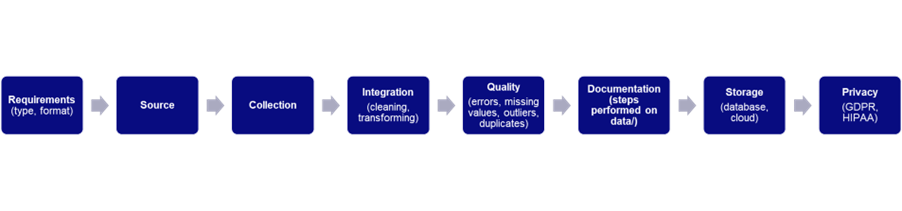

# Forcing data for flood hazard assessment

In flood modeling, several datasets are required for modelling: Digital Elevation Model, land use information, and forcings data.  This notebook primarily focuses on exploring these two flood sources:
- 	Global Tide and Surge Model (GTSM) by Deltares: water level as main driver for coastal flood-related forcings
- 	ERA5 dataset by the European Space Agency (ESA): Meteorological dataset (rainfall) as main driver for pluvial and fluvial flood forcings.
 
The datasets have already been downloaded and stored in the local directory, making them easily accessible for data analysis. Whether you are working with these specific datasets or substituting them with your own local data, this notebook serves as a foundation for explore your flood forcing data
y.

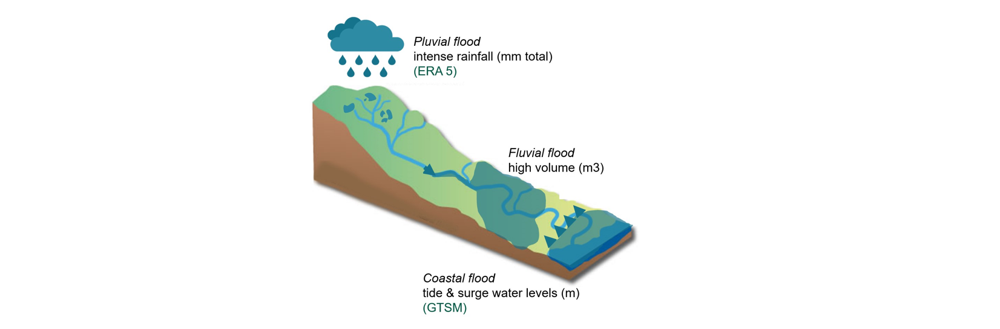

# Semarang as a case study

Semarang is a key focal point for The World Bank's strategic investments in flood risk reduction, faces unique challenges, compound flooding from coastal and river. Local subsidence rates reveal an average sinking of approximately 60 mm per year, with some areas experiencing a more alarming subsidence of up to 15 cm annually. With high economic growth, surge in urbanization, and growing concerns related to climate change, the flood is in the region is expected to be alarming if immediate measures are not taken.

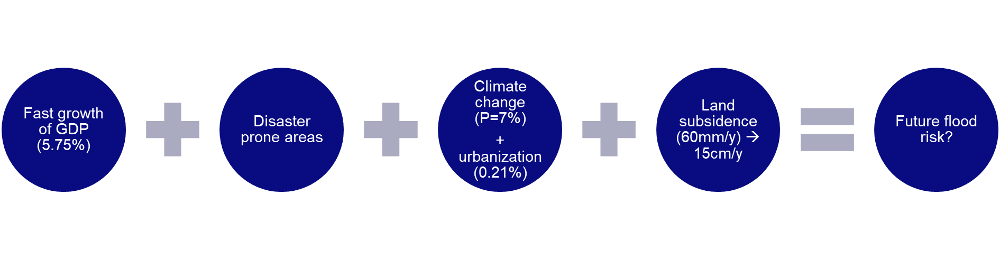

# Importing Python libraries

Libraries consist of pre-written code and functions created by other developers. Libraries are collections of modules and functions that provide specific functionality. In this notebook, these libraries will be used:
-  opening various types of data files: pandas, netcdf, pathlib
- general-purpose data manipulation and handling: xarray, pandas, time, num
- data visualization: Matplotlib and Bokeh, with the ability to display interactive plots directly in the Jupyter Notebook.


In [3]:
import xarray as xr
import pandas as pd
import netCDF4
from datetime import datetime, timedelta
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import numpy as np
from IPython.display import HTML

from bokeh.plotting import figure, show
from bokeh.io import output_notebook

output_notebook()

Loading BokehJS ...

# NetCDF: Network Common Data Form
NetCDF (Network Common Data Form) is a versatile file format commonly used in scientific research, particularly in fields like climate science (complex and large).
- storing both data and metadata in an organized way.
- space-efficient, support data compression
- interoperability with various programming languages

What are the multidimensional datasets in this netcdf?

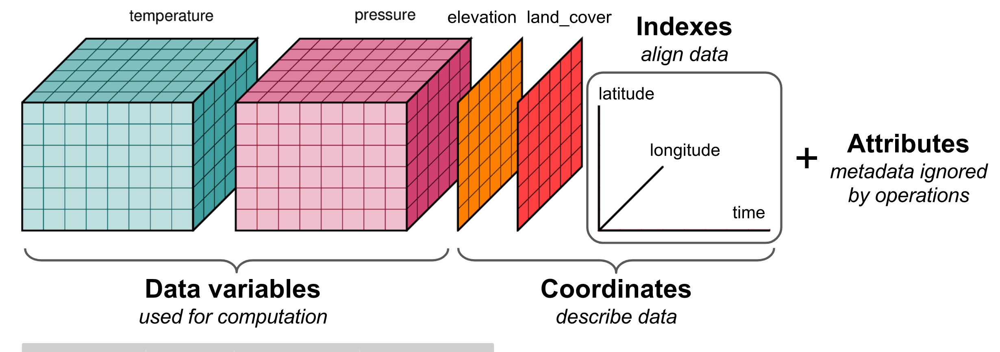

# Let's explore our data

The data's location and the file name are described in the file.

Considering that our dataset spans 30 years and contains hourly records, visualizing it at the same figure would be challenging. To address this, we can narrow our focus to a specific event, which consists only on a few days' of data. To achieve this, we can slice the dataset accordingly.
y.

In [4]:
station = 12932

target_date = datetime.strptime(biggest_event_date, "%d-%m-%Y")
print (target_date)

# Define the sliding window
days_before = event_windows
days_after = event_windows
# Calculate the date range
start_date = target_date - timedelta(days=days_before)
end_date = target_date + timedelta(days=days_after)

# Retrieve the data
forcing_file = "waterlevel.nc"
waterlevel_data = pathlib.Path(data_folder, forcing_file)

fluvial_file = "precip_era5.nc"
fluvial_data = pathlib.Path(data_folder, fluvial_file)

2019-01-21 00:00:00



# Let's explore the spatial information:

A visual representation of the data's geographic coordinate is created.

Within the opened file, the data is geolocated using which will be convered to Web WGS84 Mercator coordinate system. This step can also be carried out within Geographic Information System (GIS) software. But when dealing with large ammount of data, Python automation becomes advantageous. The dataset accurately reflects Semarang's geographical location. The water level measurements are situated in the sea, while the rainfall measurements pertain to  theland.

In [5]:
def wgs84_to_web_mercator(lat, lon):
    print(lat, lon)

    k = 6378137
    x = lon * (k * np.pi/180.0)
    y = np.log(np.tan((90 + lat) * np.pi/360.0)) * k

    return x, y

TOOLTIPS = [('Station name: ', 'Stasiun Hidrologi'),]

p = figure()

l1 = wgs84_to_web_mercator(-7.6, 109.5)
l2 = wgs84_to_web_mercator(-6.2, 111)

# range bounds supplied in web mercator coordinates
p = figure(x_axis_type="mercator", y_axis_type="mercator", tooltips=TOOLTIPS, x_range=(l1[0], l2[0]), y_range=(l1[1], l2[1]))

p.add_tile("CartoDB Positron", retina=True)

waterlevel_ds = xr.open_dataset(waterlevel_data, engine="netcdf4")
x,y = wgs84_to_web_mercator(waterlevel_ds['station_y_coordinate'].values, waterlevel_ds['station_x_coordinate'].values)
p.circle(x, y)

fluvial_ds = xr.open_dataset(fluvial_data, engine="netcdf4")
print(fluvial_ds)
x,y = wgs84_to_web_mercator(fluvial_ds['y'].values, fluvial_ds['x'].values)
p.circle(x, y)

show(p)


-7.6 109.5
-6.2 111
[-6.929] [110.347]
<xarray.Dataset>
Dimensions:      (index: 1, time: 376944)
Coordinates:
    y            (index) float32 ...
    x            (index) float32 ...
  * time         (time) datetime64[ns] 1979-01-01 ... 2021-12-31T23:00:00
    spatial_ref  int32 ...
Dimensions without coordinates: index
Data variables:
    precip       (time, index) float32 ...
[-7.] [110.5]


# Sea water level: the main driver of coastal flooding

A plot illustrating sea levels in a specified event is generated. Highest water level is identified. In Semarang, the presence of a sea wall is crucial, standing at an elevation of 1.8 meters. This protective barrier is crucial because the local terrain lies below sea level.


In [6]:
forcing_file = "waterlevel_gtsm_dailymax.nc"
waterlevel_data = pathlib.Path(data_folder, forcing_file)

ds = xr.open_dataset(waterlevel_data, engine="netcdf4")
water_level_var = ds["waterlevel"]
water_level_df = water_level_var.to_dataframe().reset_index()

sliced_water_level_df = water_level_df[(water_level_df['time'] >= start_date) & (water_level_df['time'] <= end_date) & (water_level_df['stations'] == station)]
max_water_level = sliced_water_level_df['waterlevel'].max()


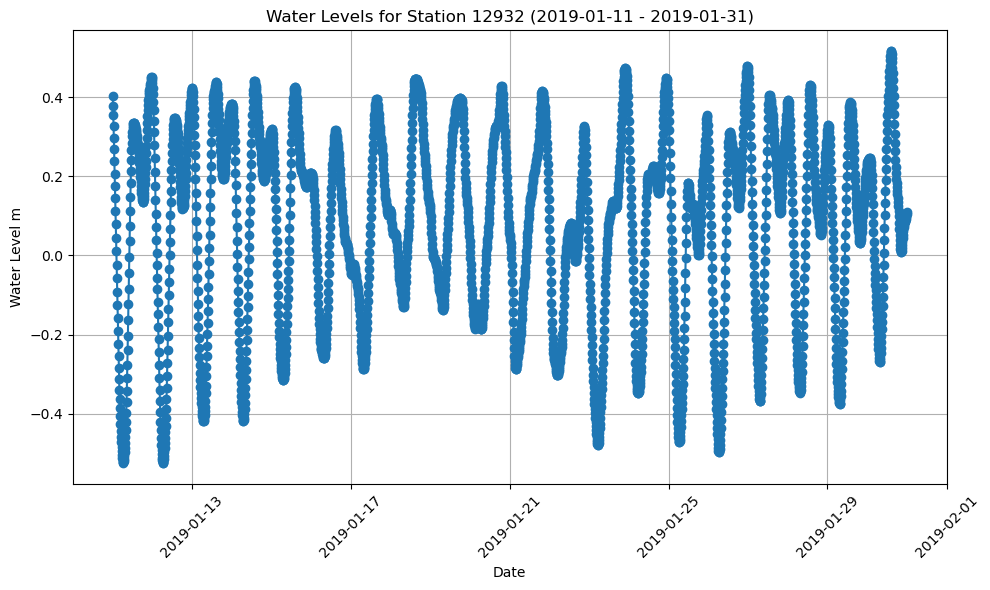

In [7]:
plt.figure(figsize=(10, 6))
plt.plot(sliced_water_level_df['time'], sliced_water_level_df['waterlevel'], marker='o')
plt.title(f'Water Levels for Station {station} ({start_date.date()} - {end_date.date()})')
plt.xlabel('Date')
plt.ylabel('Water Level m')
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()

# Show the plot
plt.show()

# Rainfall: the main driver of fluvial and pluvial flooding

A plot illustrating rainfall in a specified event is generated. Converting rainfall data into fluvial flood is more complex than sea level to coastal flood. The total rainfall height is obtained from the global data will later be converted into flood volume using rational method.


In [8]:
fluvial_file = "precip_era5.nc"
fluvial_data = pathlib.Path(data_folder, fluvial_file)

ds = xr.open_dataset(fluvial_data, engine="netcdf4")
precipitation_var = ds["precip"]
precipitation_df = precipitation_var.to_dataframe().reset_index()
precipitation_df2 = precipitation_df[precipitation_df["precip"] != 0]
precipitation_df2.dropna(subset=['precip'], inplace=True)
precipitation_df2.to_csv("pdata.csv", sep=';')


sliced_precipitation_df = precipitation_df[(precipitation_df['time'] >= start_date) & (precipitation_df['time'] <= end_date)]
print (sliced_precipitation_df)
print (precipitation_df['time'] >= start_date)
print (precipitation_df['time'] <= end_date)
total_precip = np.nanmean(sliced_precipitation_df["precip"])*sliced_precipitation_df.shape[0]/1000


                      time  index    y      x  spatial_ref    precip
350880 2019-01-11 00:00:00      0 -7.0  110.5            0  0.728670
350881 2019-01-11 01:00:00      0 -7.0  110.5            0  0.153594
350882 2019-01-11 02:00:00      0 -7.0  110.5            0  0.002380
350883 2019-01-11 03:00:00      0 -7.0  110.5            0  0.078581
350884 2019-01-11 04:00:00      0 -7.0  110.5            0  0.164308
...                    ...    ...  ...    ...          ...       ...
351356 2019-01-30 20:00:00      0 -7.0  110.5            0  1.533538
351357 2019-01-30 21:00:00      0 -7.0  110.5            0  0.541739
351358 2019-01-30 22:00:00      0 -7.0  110.5            0  0.144068
351359 2019-01-30 23:00:00      0 -7.0  110.5            0  0.059534
351360 2019-01-31 00:00:00      0 -7.0  110.5            0  0.028577

[481 rows x 6 columns]
0         False
1         False
2         False
3         False
4         False
          ...  
376939     True
376940     True
376941     True
3769

C:\Users\hermawan\AppData\Local\Temp\ipykernel_7184\2201166968.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  precipitation_df2.dropna(subset=['precip'], inplace=True)


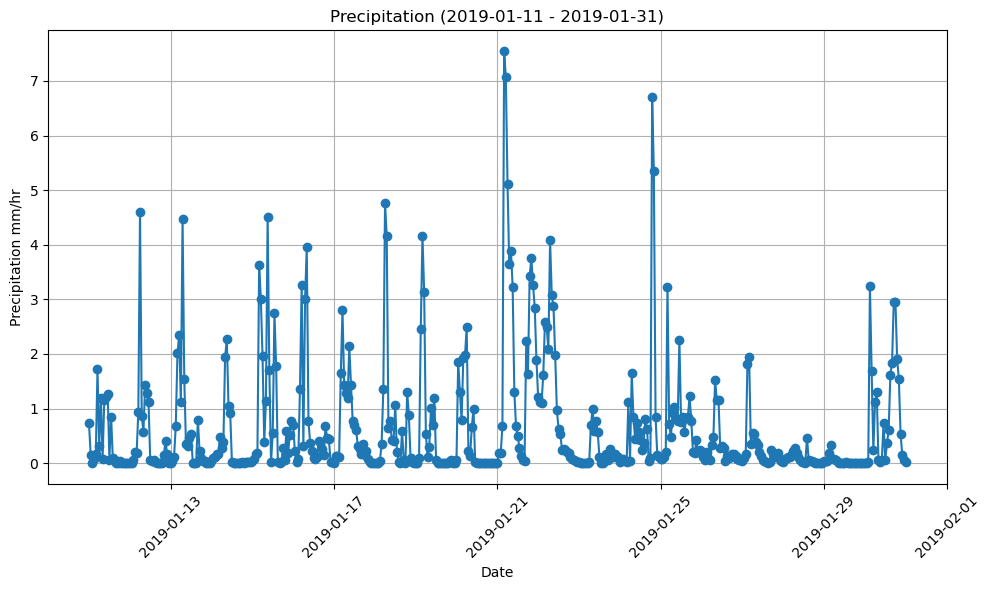

In [9]:
plt.figure(figsize=(10, 6))
plt.plot(sliced_precipitation_df['time'], sliced_precipitation_df['precip'], marker='o')
plt.title(f'Precipitation ({start_date.date()} - {end_date.date()})')
plt.xlabel('Date')
plt.ylabel('Precipitation mm/hr')
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()

# Show the plot
plt.show()


TODO: this code needs cleaning up
This code below is WIP to clean up the code in the cell below this.

In [10]:
total_precip = sliced_precipitation_df['precip'].sum()
# print(total_precip)
duration = 999999

for start_index in range(len(sliced_precipitation_df)):
    cum_precip = sliced_precipitation_df.iloc[start_index:]['precip'].cumsum()
    precip_threshold = np.where(cum_precip >= total_precip * 0.5 )[0]
    if len(precip_threshold) == 0:
        continue
    end_index = precip_threshold[0]
    if end_index < duration:
        duration = end_index
        best_start_time = pd.Timestamp(sliced_precipitation_df.iloc[start_index]['time'])
        best_end_time = pd.Timestamp(sliced_precipitation_df['time'].values[start_index + end_index])
        shortest_duration = best_end_time - best_start_time
    start_index += 1



# Let's explore the temporal information:

In the context of fluvial flooding, it's not just the total rainfall volume that matters, but also how it is distributed over time.
A l way to assess rainfall is by considering the shortest time period within which 50(or 75%, or 80%) % of the total volume accumulate . When this shortest duration is very brief, it signifies an exceptionally intenst rainfall eventThis implies thele time for the water to infiltrate the grou is short whichd, elevesng the risk of flooding.

For illustration, let's examine the graph below. In this example, the red rainfall curve is significantly more catastrophic than the b. e oThus, hat these parameters should be factored in when analyzing rainfall data.

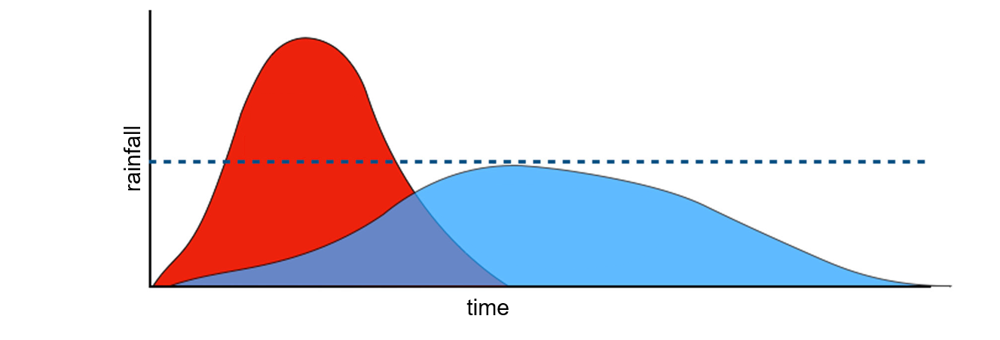

C:\Users\hermawan\AppData\Local\Temp\ipykernel_7184\246318572.py:17: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  moving_start.set_data(start_time, sliced_precipitation_df.iloc[start_index]['precip'])
Animation size has reached 21011552 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Start Time: 2019-01-16 04:00:00
End Time: 2019-01-22 15:00:00
Shortest Duration: 6 days 11:00:00
Max water level (m) during selected period is 0.5170000195503235
Total precipitation (m) during selected period is 312.1357421875
Smallest percentage of time when rainfall volume reached 50% is 0.3229166666666667


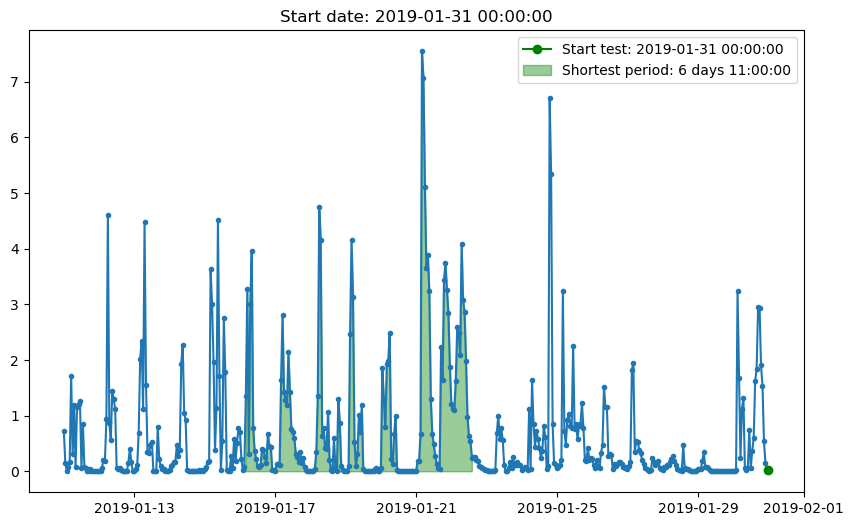

In [11]:
fig, ax = plt.subplots(1, 1)
fig.set_size_inches((10, 6))
ax.set_title('test')
ax.plot(sliced_precipitation_df['time'], sliced_precipitation_df['precip'], marker='.')
moving_start, = ax.plot([], [], color='green', label='Start time', marker='o')
total_precip = sliced_precipitation_df['precip'].sum()
dynamic_fill = ax.fill_between([], [])
result_fill = ax.fill_between([], [])
duration = 999999

def animate(start_index):
    global duration, dynamic_fill, result_fill, shortest_duration, best_start_time, best_start_time
    start_time = pd.Timestamp(sliced_precipitation_df.iloc[start_index]['time'])
    ax.set_title(f"Start date: {start_time}")
    cum_precip = sliced_precipitation_df.iloc[start_index:]['precip'].cumsum()
    precip_threshold = np.where(cum_precip >= total_precip * 0.5 )[0]
    moving_start.set_data(start_time, sliced_precipitation_df.iloc[start_index]['precip'])
    moving_start.set_label(f"Start test: {start_time}")
    dynamic_fill.remove()
    if not len(precip_threshold) == 0:
        end_index = precip_threshold[0]
        x = sliced_precipitation_df.iloc[start_index: start_index + end_index]['time']
        y = sliced_precipitation_df.iloc[start_index: start_index + end_index]['precip']
        start_time = pd.Timestamp(sliced_precipitation_df.iloc[start_index]['time'])
        end_time = pd.Timestamp(sliced_precipitation_df['time'].values[start_index + end_index])
        dynamic_fill = ax.fill_between(x, y, color="blue", alpha=0.3)
        dynamic_fill.set_label(f"Period 50% percipitation: {end_time - start_time}")
        if end_index < duration:
            duration = end_index
            best_start_time = start_time
            best_end_time = end_time
            shortest_duration = best_end_time - best_start_time
            result_fill.remove()
            result_fill = ax.fill_between(x, y, color="green", alpha=0.4)
            result_fill.set_label(f"Shortest period: {shortest_duration}")
    else:
        x = sliced_precipitation_df.iloc[start_index: -1]['time']
        y = sliced_precipitation_df.iloc[start_index: -1]['precip']
        dynamic_fill = ax.fill_between(x, y, color="red", alpha=0.3)
    plt.legend()


animation = FuncAnimation(fig=fig, func=animate, frames=len(sliced_precipitation_df))

display(HTML(animation.to_jshtml()))

# Print the result
print(f"Start Time: {best_start_time}")
print(f"End Time: {best_end_time}")
print(f"Shortest Duration: {shortest_duration}")


#PRINT FLUVIAL AND COASTAL FORCING========================================
print(f"Max water level (m) during selected period is {max_water_level}")
print(f"Total precipitation (m) during selected period is {total_precip}")
print(f"Smallest percentage of time when rainfall volume reached 50% is {shortest_duration/timedelta(days=event_windows*2)}")